# Lab 6: Unsupervised Learning II - Dimensionality Reduction

In this lab, we will cover the following topics:
1. Dimensionality reduction techniques:
   * PCA
   * t-SNE
   * UMAP
2. Visualization and interpretation

Each section includes basic implementation and questions for further exploration.

## 1. Dimensionality Reduction

### 1.1 Principal Component Analysis (PCA)

We will start by implementing PCA for dimensionality reduction. We will also explore different parameters and visualize the results.

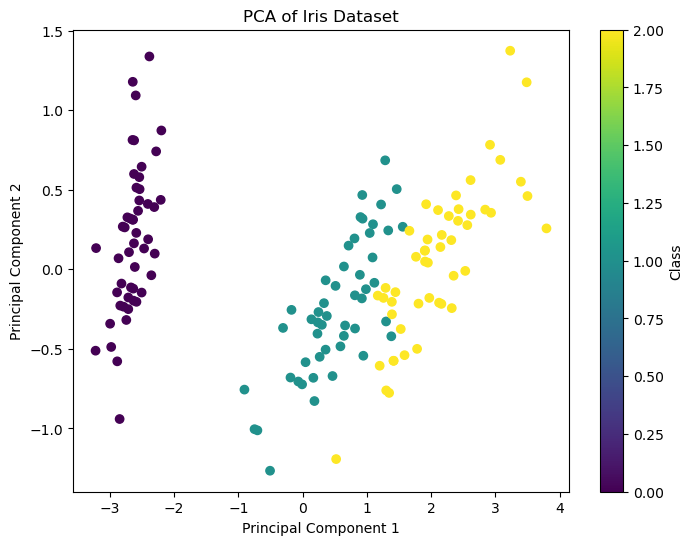

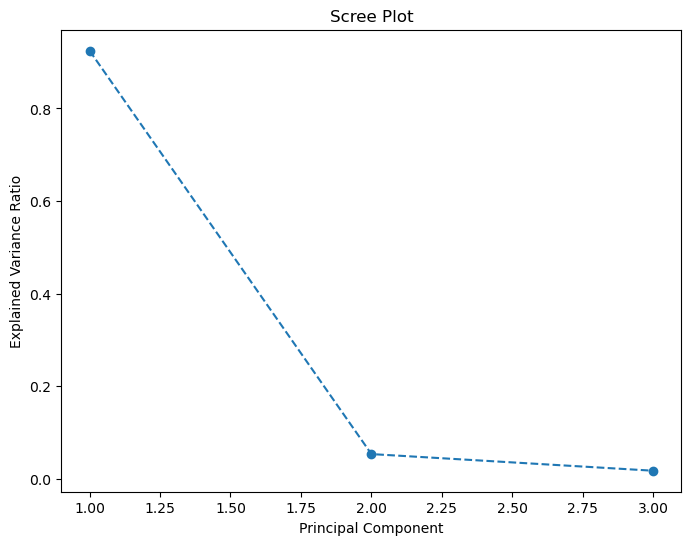

In [39]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import load_iris
from sklearn.decomposition import PCA

# Load the Iris dataset
iris = load_iris()
X = iris.data
y = iris.target

# Perform PCA
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X)

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Iris Dataset')
plt.colorbar(label='Class')
plt.show()

# Scree plot
explained_variance = pca.explained_variance_ratio_
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='--')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.show()

### Questions for Exploration

1. How does changing the number of principal components (`n_components`) affect the explained variance ratio?
    Increasing it does decrease the variance ratio to around 0.1 bw 3-4 components, however there is a significant difference in the varaince bw 2 and 3 componments 
2. What happens to the visualization when you use more or fewer principal components?
3. How does the choice of dataset affect the PCA results and their interpretation?
    Because different dataset will have differences in how they are recorded and the variance bw each componment , does not mean that each dat set will have the same interpreation if we use the same number of components

### 1.2 t-Distributed Stochastic Neighbor Embedding (t-SNE)

Next, we will implement t-SNE for dimensionality reduction. We will also explore different parameters and visualize the results.

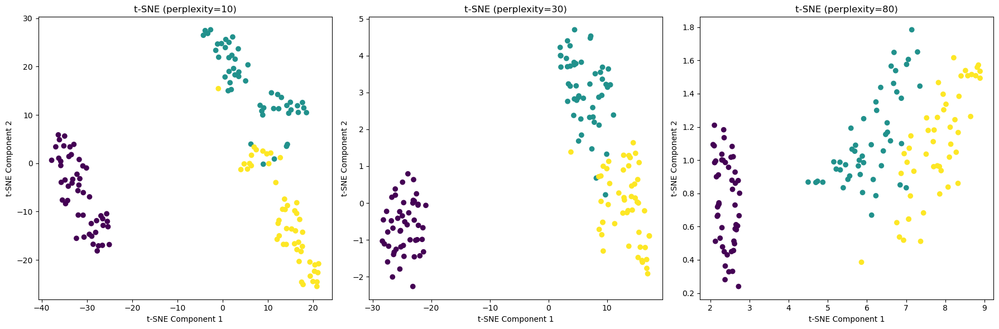

In [40]:
from sklearn.manifold import TSNE

# Perform t-SNE with different perplexity values
perplexities = [10, 30, 80]
fig, axes = plt.subplots(1, len(perplexities), figsize=(18, 6))

for i, perplexity in enumerate(perplexities):
    tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42)
    X_tsne = tsne.fit_transform(X)
    axes[i].scatter(X_tsne[:, 0], X_tsne[:, 1], c=y, cmap='viridis')
    axes[i].set_title(f't-SNE (perplexity={perplexity})')
    axes[i].set_xlabel('t-SNE Component 1')
    axes[i].set_ylabel('t-SNE Component 2')

plt.tight_layout()
plt.show()


### Questions for Exploration

1. How does changing the perplexity parameter affect the t-SNE visualization?
    if the perplexity is higher , we will see less small clustering, will give us idea about larger subset clusters in the data, 
2. What happens to the visualization when you change the learning rate?
3. How does the choice of dataset affect the t-SNE results and their interpretation?

### 1.3 Uniform Manifold Approximation and Projection (UMAP)

Finally, we will implement UMAP for dimensionality reduction. We will also explore different parameters and visualize the results.

d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\sklearn\utils\deprecation.py:151:

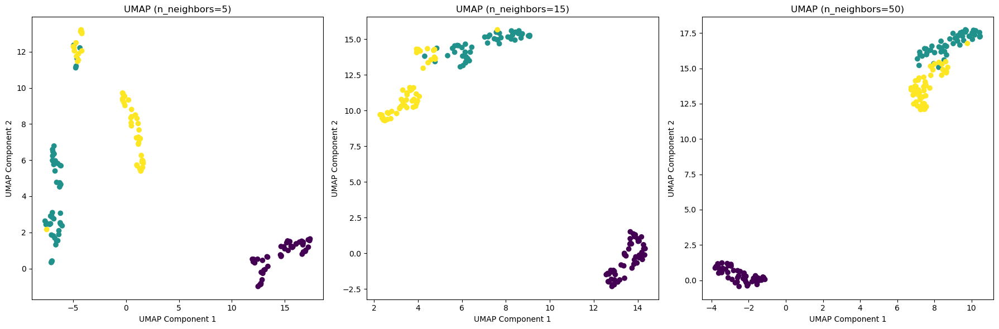

In [41]:
import umap


# Perform UMAP with different n_neighbors values
n_neighbors_values = [5, 15, 50]
fig, axes = plt.subplots(1, len(n_neighbors_values), figsize=(18, 6))

for i, n_neighbors in enumerate(n_neighbors_values):
    umap_reducer = umap.UMAP(n_components=2, n_neighbors=n_neighbors, random_state=42)
    X_umap = umap_reducer.fit_transform(X)
    axes[i].scatter(X_umap[:, 0], X_umap[:, 1], c=y, cmap='viridis')
    axes[i].set_title(f'UMAP (n_neighbors={n_neighbors})')
    axes[i].set_xlabel('UMAP Component 1')
    axes[i].set_ylabel('UMAP Component 2')

plt.tight_layout()
plt.show()


### Questions for Exploration

1. How does changing the number of neighbors (`n_neighbors`) affect the UMAP visualization?
2. What happens to the visualization when you change the minimum distance (`min_dist`)?
3. How does the choice of dataset affect the UMAP results and their interpretation?

## 2. Visualization and Interpretation

We will visualize and interpret the results of different dimensionality reduction techniques. We will also explore different visualization techniques.

d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
d:\VSCode ProjectsRepos\BINF-5007-Materials\.pixi\envs\default\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


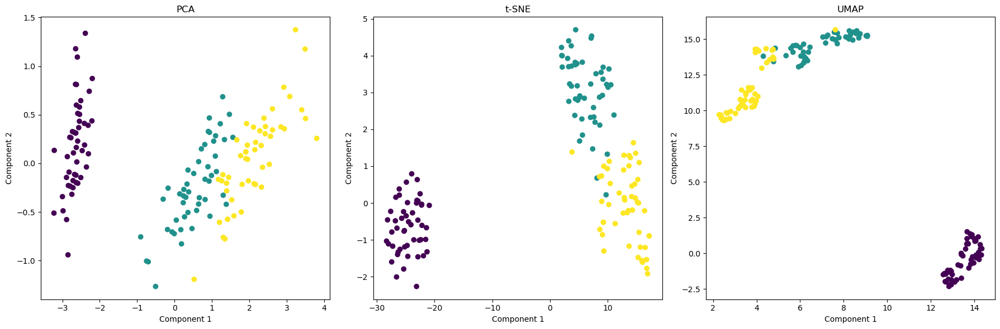

In [42]:
# Load the Iris dataset
iris = load_iris()
X = iris.data
y = iris.target

# Perform PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Perform t-SNE
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

# Perform UMAP
umap_reducer = umap.UMAP(n_components=2, random_state=42)
X_umap = umap_reducer.fit_transform(X)

# Plot the results
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

axes[0].scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
axes[0].set_title('PCA')
axes[0].set_xlabel('Component 1')
axes[0].set_ylabel('Component 2')

axes[1].scatter(X_tsne[:, 0], X_tsne[:, 1], c=y, cmap='viridis')
axes[1].set_title('t-SNE')
axes[1].set_xlabel('Component 1')
axes[1].set_ylabel('Component 2')

axes[2].scatter(X_umap[:, 0], X_umap[:, 1], c=y, cmap='viridis')
axes[2].set_title('UMAP')
axes[2].set_xlabel('Component 1')
axes[2].set_ylabel('Component 2')

plt.tight_layout()
plt.show()


### Questions for Exploration

1. How do the visualizations of PCA, t-SNE, and UMAP compare?
2. What are the strengths and weaknesses of each dimensionality reduction technique?
3. How does the choice of parameters affect the visualization and interpretation of each technique?

## Extensions

1. Apply clustering algorithms (e.g., k-Means) on the reduced dimensions obtained from PCA, t-SNE, and UMAP.
    * How do the clustering results compare when using different dimensionality reduction techniques?
2. Use quantitative metrics (e.g., trustworthiness, continuity) to evaluate the quality of the dimensionality reduction.
    * How do PCA, t-SNE, and UMAP compare based on these metrics?
Handling High-Dimensional Data
3. Use PCA to reduce noise in a dataset by retaining only the top principal components.
    * How does this noise reduction affect the performance of downstream tasks (e.g., classification, clustering)?
4. Explore other dimensionality reduction techniques such as Independent Component Analysis (ICA), Linear Discriminant Analysis (LDA), and Isomap.
    * How do these techniques compare to PCA, t-SNE, and UMAP in terms of visualization and interpretation?

In [43]:
clinical_data = pd.read_csv('clinical.csv') # Replace with your clinical data file
rna_seq = pd.read_csv('tpm_counts.csv') # Replace with your RNA-seq data file


In [44]:
print("number of genes in the dataset:", rna_seq.shape[1])

rna_seq_reduced = rna_seq.loc[:, rna_seq.isnull().mean()<0.25] # Remove genes with more than 25% missing values

print("number of genes after removing those with more than 25% missing values:", rna_seq_reduced.shape[1])



number of genes in the dataset: 22127
number of genes after removing those with more than 25% missing values: 11122


In [45]:
rna_seq.isnull()

,Unnamed: 0,1/2-SBSRNA4,A1BG,A1BG-AS1,A1CF,A2LD1,A2M,A2ML1,A2MP1,A4GALT,...,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3,tAKR
0,False,True,True,True,True,False,False,True,True,False,...,True,False,False,False,True,False,False,False,False,True
1,False,True,False,True,True,False,False,False,True,False,...,False,False,False,False,True,False,False,False,False,False
2,False,True,False,True,True,False,False,False,True,False,...,False,False,False,False,True,False,False,False,False,True
3,False,True,False,False,True,False,False,True,True,False,...,False,False,False,False,True,False,False,False,False,True
4,False,True,False,True,True,False,False,True,True,False,...,False,False,False,False,True,False,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125,False,True,False,False,True,True,False,True,True,False,...,False,False,False,False,True,False,False,False,False,True
126,False,True,False,False,True,True,False,True,False,False,...,True,False,False,False,True,False,False,False,False,True
127,False,True,True,False,True,True,False,True,True,False,...,False,False,False,False,True,False,False,False,False,True
128,False,True,False,False,True,True,False,True,False,False,...,False,False,False,False,False,False,False,False,False,True


In [46]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5)
rna_seq_imputed = imputer.fit_transform(rna_seq_reduced.iloc[:,1:])

In [48]:
rna_seq_patients = rna_seq_reduced['Case ID']
clinical_data_with_seq = clinical_data[clinical_data['Case ID'].isin(rna_seq_patients)]

KeyError: 'Case ID'

In [ ]:
pca = PCA(n_components=3)
X_pca = pca.fit_transform(rna_seq_imputed)

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of RNA-seq Data')
plt.colorbar(label='Class')
plt.show()

# Scree plot
explained_variance = pca.explained_variance_ratio_
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='--')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.show()

In [49]:
clinical_data = pd.read_csv('clinical.csv') # Replace with your clinical data file
rna_seq = pd.read_csv('tpm_counts.csv') # Replace with your RNA-seq data file

# Check the columns in rna_seq_reduced to find the correct column name
print("rna_seq_reduced columns:", rna_seq_reduced.columns.tolist())

rna_seq_reduced columns: ['Unnamed: 0', 'A2M', 'A4GALT', 'AAAS', 'AACS', 'AADAT', 'AAGAB', 'AAK1', 'AAMP', 'AARS', 'AARS2', 'AARSD1', 'AASDH', 'AASDHPPT', 'AASS', 'AATF', 'ABAT', 'ABCA1', 'ABCA11P', 'ABCA12', 'ABCA13', 'ABCA2', 'ABCA3', 'ABCA5', 'ABCA6', 'ABCA7', 'ABCB10', 'ABCB6', 'ABCB7', 'ABCB8', 'ABCC1', 'ABCC10', 'ABCC3', 'ABCC4', 'ABCC5', 'ABCC6', 'ABCC9', 'ABCD1', 'ABCD3', 'ABCD4', 'ABCE1', 'ABCF2', 'ABCF3', 'ABCG1', 'ABHD10', 'ABHD11', 'ABHD12', 'ABHD13', 'ABHD14B', 'ABHD15', 'ABHD16B', 'ABHD2', 'ABHD3', 'ABHD4', 'ABHD5', 'ABHD6', 'ABHD8', 'ABI1', 'ABI2', 'ABI3', 'ABI3BP', 'ABL1', 'ABL2', 'ABLIM1', 'ABLIM3', 'ABO', 'ABR', 'ABT1', 'ABTB1', 'ABTB2', 'ACAA1', 'ACAA2', 'ACACA', 'ACACB', 'ACAD10', 'ACAD8', 'ACAD9', 'ACADM', 'ACADS', 'ACADSB', 'ACADVL', 'ACAP1', 'ACAP2', 'ACAP3', 'ACAT1', 'ACAT2', 'ACBD3', 'ACBD4', 'ACBD5', 'ACBD6', 'ACCS', 'ACD', 'ACE', 'ACER2', 'ACER3', 'ACIN1', 'ACLY', 'ACN9', 'ACO1', 'ACO2', 'ACOT11', 'ACOT13', 'ACOT2', 'ACOT7', 'ACOT8', 'ACOT9', 'ACOX1', 'ACOX3'